# About Dataset

The data contains information from the 1990 California census. So, although it may not help you with predicting current housing prices, it does provide an accessible introduction dataset for teaching people about the basics of machine learning

# A. PROBLEM STATEMENT

**Development of a Housing Price Prediction Model to Enhance Market Strategy and Customer Insight**

## 1. Background

In the current real estate market, accurate pricing of properties is crucial for both buyers and sellers. 

As a housing company, we aim to provide our clients with reliable and data-driven insights into property values. The housing market is influenced by various factors, including location, property features, economic conditions, and demographic trends. However, the dynamic nature of these factors makes it challenging to determine fair market prices for properties.

## 2. Problem Statement

Our company is facing difficulties in accurately pricing properties, leading to several challenges:

1. **Inconsistent Pricing** : Without a standardized method for pricing, properties may be undervalued or overvalued, resulting in lost sales opportunities or dissatisfied customers.

2. **Market Competitiveness** : In a competitive market, having accurate pricing information is essential to attract buyers and sellers. Inaccurate pricing can lead to properties sitting on the market for extended periods, affecting our market reputation.

3. **Customer Trust** : Clients rely on our expertise to guide them in their real estate decisions. If we cannot provide accurate price estimates, it may erode their trust in our services.

4. **Resource Allocation** : Inefficient pricing strategies can lead to misallocation of marketing resources, where properties that are priced too high may not receive adequate attention, while undervalued properties may not be marketed effectively.


## 3. Objective

To address these challenges, we propose the development of a housing price prediction model that leverages historical data and various influencing factors to provide accurate and reliable property valuations. The model will aim to:

1. **Predict Median House Values** : Utilize a regression-based approach to predict the median house value based on key features such as location, number of rooms, and local amenities.

2. **Enhance Pricing Strategies** : Provide our sales team with data-driven insights to set competitive prices for properties, ensuring alignment with market trends.

3. **Improve Customer Experience** : Offer potential buyers and sellers accurate price estimates, enhancing their decision-making process and overall satisfaction with our services.

4. **Optimize Marketing Efforts** : Enable targeted marketing strategies by identifying properties that are priced competitively and those that may require adjustments.

## 4. Expected Outcomes

1. **A predictive model** that accurately estimates housing prices based on a comprehensive analysis of relevant features.
2. Improved pricing strategies that align with market conditions, leading to increased sales and customer satisfaction.
3. Enhanced reputation as a data-driven real estate company that provides valuable insights to clients.

By implementing this housing price prediction model, we aim to position our company as a leader in the real estate market, leveraging data analytics to drive informed decision-making and foster trust with our clients.

# B. DATA PREPARATION

## 1. Libraries

In [12]:
# Data Manipulation  
import pandas as pd  
import numpy as np  
  
# Statistics  
from scipy import stats  
from scipy.stats import uniform, randint  
  
# Visualization & Map  
import matplotlib.pyplot as plt  
import seaborn as sns  
import folium  
from folium.plugins import MarkerCluster  
  
# Preprocessing and Model Selection  
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold  
from sklearn.preprocessing import StandardScaler, OneHotEncoder, RobustScaler  
from sklearn.impute import SimpleImputer  
from sklearn.pipeline import Pipeline  
from sklearn.compose import ColumnTransformer  
from sklearn.utils import resample  
  
# Modeling  
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet  
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, IsolationForest
from sklearn.tree import DecisionTreeRegressor  
from sklearn.neighbors import KNeighborsRegressor  
from sklearn.svm import SVR  
from sklearn.neural_network import MLPRegressor  
from xgboost import XGBRegressor  
# from catboost import CatBoostRegressor  
from lightgbm import LGBMRegressor  

# Model Evaluation  
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, make_scorer  
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, KFold

## 2. Data Load

In [13]:
df = pd.read_csv("data_california_house.csv")
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
0,-119.79,36.73,52.0,112.0,28.0,193.0,40.0,1.9750,INLAND,47500.0
1,-122.21,37.77,43.0,1017.0,328.0,836.0,277.0,2.2604,NEAR BAY,100000.0
2,-118.04,33.87,17.0,2358.0,396.0,1387.0,364.0,6.2990,<1H OCEAN,285800.0
3,-118.28,34.06,17.0,2518.0,1196.0,3051.0,1000.0,1.7199,<1H OCEAN,175000.0
4,-119.81,36.73,50.0,772.0,194.0,606.0,167.0,2.2206,INLAND,59200.0


## 3. Features Description

About this features description 
based on Kaggle (https://www.kaggle.com/datasets/camnugent/california-housing-prices/data) :

- `longitude` : a measure of how fare west a west house is, a higher value is father west
- `latitude` : a measure of how far north a house is; a higher value is father north
- `housing_median_age` : median age of a house within a block; lower number is newer building
- `total_rooms` : total number of bedrooms within a block
- `population` : total number of people residing within a block
- `households` : total number of households, a group of people reising within a home unit, for a block
- `median_income` : median income for households within a block of houses (measured in tens of thousands of US Dollars)
- `ocean_proximity` : location of the house w.r.t ocean / sea
- `median_house_value` : median house value for households within a block (measured in US Dollars)

**Ocean Proximity Explanation :**

- `ISLAND` : this indicates the house is located on an island
- `<1H OCEAN` : this indicates the house is less than one hour away from the ocean.
- `NEAR OCEAN` : the block is close to the ocean than `<1H OCEAN`
- `NEAR BAY` : the block is near a bay, which is a body of water connected to an ocean or lake
- `INLAND` : this means the house is not near the coast; it is located inland

In [14]:
## Data Summary
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,14448.000000,14448.000000,14448.000000,14448.000000,14311.000000,14448.000000,14448.000000,14448.000000,14448.000000
mean,-119.566647,35.630093,28.618702,2640.132683,538.260709,1425.157323,499.508929,3.866667,206824.624516
std,2.006587,2.140121,12.596694,2191.612441,423.577544,1149.580157,383.098390,1.891158,115365.476182
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1451.000000,295.000000,784.000000,279.000000,2.570600,119600.000000
50%,-118.490000,34.260000,29.000000,2125.000000,435.000000,1165.000000,410.000000,3.539100,180000.000000
75%,-118.000000,37.710000,37.000000,3148.000000,647.000000,1724.000000,604.000000,4.736100,263900.000000
max,-114.310000,41.950000,52.000000,32627.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


## 4. Duplicate Check

In [15]:
# Detecting Duplicate
df.duplicated().sum()

np.int64(0)

There is no duplicated data. We can continue

## 5. Missing Value Handling

In [16]:
# Detecting missing value
df.isnull().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        137
population              0
households              0
median_income           0
ocean_proximity         0
median_house_value      0
dtype: int64

There are 137 missing values in `total_bedroom` column

In [17]:
missing_value_row = df[df.isnull().any(axis=1)]
missing_value_row

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
88,-121.47,38.61,31.0,1072.0,NaN,781.0,281.0,1.6563,INLAND,65800.0
119,-117.28,34.26,18.0,3895.0,NaN,1086.0,375.0,3.3672,INLAND,133600.0
251,-117.61,34.08,12.0,4427.0,NaN,2400.0,843.0,4.7147,INLAND,158700.0
340,-122.70,38.35,14.0,2313.0,NaN,954.0,397.0,3.7813,<1H OCEAN,146500.0
410,-122.42,40.44,16.0,994.0,NaN,495.0,181.0,2.1875,INLAND,76400.0
...,...,...,...,...,...,...,...,...,...,...
13856,-117.96,34.03,35.0,2093.0,NaN,1755.0,403.0,3.4115,<1H OCEAN,150400.0
13932,-117.87,33.83,27.0,2287.0,NaN,1140.0,351.0,5.6163,<1H OCEAN,231000.0
13989,-118.40,34.17,24.0,6347.0,NaN,2945.0,1492.0,3.3545,<1H OCEAN,221500.0
14308,-118.55,34.19,18.0,5862.0,NaN,3161.0,1280.0,3.1106,<1H OCEAN,170600.0


Because the missing value is low (under 1%, i decided to delete them)

In [18]:
df = df.dropna()

Missing value has been deleted

## 6. Feature Engineering : Add Features

### a. Ratio Based Features

I will add some ratio features to the dataset.
Hope by adding these features can help the model make more accurate predictions.

In [19]:
df['room_per_household'] = df['total_rooms'] / df['households']
df['population_per_household'] = df['population'] / df['households']
df["bedrooms_ratio"] = df["total_bedrooms"] / df["total_rooms"]
df["income_household"] = df["median_income"] / df["households"]
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household
0,-119.79,36.73,52.0,112.0,28.0,193.0,40.0,1.9750,INLAND,47500.0,2.800000,4.825000,0.250000,0.049375
1,-122.21,37.77,43.0,1017.0,328.0,836.0,277.0,2.2604,NEAR BAY,100000.0,3.671480,3.018051,0.322517,0.008160
2,-118.04,33.87,17.0,2358.0,396.0,1387.0,364.0,6.2990,<1H OCEAN,285800.0,6.478022,3.810440,0.167939,0.017305
3,-118.28,34.06,17.0,2518.0,1196.0,3051.0,1000.0,1.7199,<1H OCEAN,175000.0,2.518000,3.051000,0.474980,0.001720
4,-119.81,36.73,50.0,772.0,194.0,606.0,167.0,2.2206,INLAND,59200.0,4.622754,3.628743,0.251295,0.013297


- `room_per_household` is the number of rooms per household
- `population_per_household` is the number of people per household. Adding these new features can help the model make more accurate predictions.
- `bedrooms_ratio` is the number of bedrooms per total rooms
- `income_household` is the median income per household

### b. Income Level

In [20]:
# Based on bins
bins = [0, 3, 7, float('inf')]
labels = [1, 2, 3]  # 1 for low, 2 for average, 3 for high  
  
# Create the income_level feature  
df['income_level'] = pd.cut(df['median_income'], bins=bins, labels=labels, right=False) 
df['income_level'] = df['income_level'].astype(int)
df 

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level
0,-119.79,36.73,52.0,112.0,28.0,193.0,40.0,1.9750,INLAND,47500.0,2.800000,4.825000,0.250000,0.049375,1
1,-122.21,37.77,43.0,1017.0,328.0,836.0,277.0,2.2604,NEAR BAY,100000.0,3.671480,3.018051,0.322517,0.008160,1
2,-118.04,33.87,17.0,2358.0,396.0,1387.0,364.0,6.2990,<1H OCEAN,285800.0,6.478022,3.810440,0.167939,0.017305,2
3,-118.28,34.06,17.0,2518.0,1196.0,3051.0,1000.0,1.7199,<1H OCEAN,175000.0,2.518000,3.051000,0.474980,0.001720,1
4,-119.81,36.73,50.0,772.0,194.0,606.0,167.0,2.2206,INLAND,59200.0,4.622754,3.628743,0.251295,0.013297,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14442,-120.06,36.94,19.0,901.0,183.0,700.0,190.0,2.2375,INLAND,64300.0,4.742105,3.684211,0.203108,0.011776,1
14443,-121.26,38.27,20.0,1314.0,229.0,712.0,219.0,4.4125,INLAND,144600.0,6.000000,3.251142,0.174277,0.020148,2
14444,-120.89,37.48,27.0,1118.0,195.0,647.0,209.0,2.9135,INLAND,159400.0,5.349282,3.095694,0.174419,0.013940,1
14446,-117.93,33.62,34.0,2125.0,498.0,1052.0,468.0,5.6315,<1H OCEAN,484600.0,4.540598,2.247863,0.234353,0.012033,2


## 7. New Data Summary

In [21]:
# summary of the data
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level
count,14311.000000,14311.000000,14311.000000,14311.000000,14311.000000,14311.000000,14311.000000,14311.000000,14311.000000,14311.000000,14311.000000,14311.000000,14311.000000,14311.000000
mean,-119.567150,35.631365,28.609671,2640.917686,538.260709,1424.772273,499.480470,3.866774,206793.156942,5.425520,3.041250,0.212895,0.016109,1.698693
std,2.006374,2.139589,12.606493,2197.192896,423.577544,1151.795857,383.826005,1.890866,115404.371629,2.294973,6.900639,0.058188,0.137428,0.569598
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000,0.846154,0.750000,0.100000,0.000380,1.000000
25%,-121.800000,33.930000,18.000000,1452.000000,295.000000,784.000000,279.000000,2.569400,119400.000000,4.453362,2.426510,0.175575,0.005039,1.000000
50%,-118.490000,34.260000,29.000000,2125.000000,435.000000,1164.000000,410.000000,3.540300,180000.000000,5.230769,2.816092,0.202886,0.008449,2.000000
75%,-118.000000,37.715000,37.000000,3142.000000,647.000000,1722.000000,603.500000,4.736100,263750.000000,6.047714,3.280652,0.239186,0.014082,2.000000
max,-114.310000,41.950000,52.000000,32627.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000,132.533333,599.714286,1.000000,15.000100,3.000000


In [22]:
# Features Description
feature_descriptions = []

# Loop through each column in the DataFrame
for column in df.columns:
    # Calculate the number of null values and their percentage
    null_count = df[column].isna().sum()
    null_percentage = round((null_count / len(df[column])) * 100, 2)
    
    # Get the number of unique values and a sample of unique values
    unique_count = df[column].nunique()
    unique_sample = list(df[column].drop_duplicates().sample(min(2, unique_count)).values)
    
    # Append the feature description to the list
    feature_descriptions.append([
        column, 
        df[column].dtype, 
        null_count, 
        null_percentage, 
        unique_count, 
        unique_sample
    ])

# Create a DataFrame to summarize the features
features_summary = pd.DataFrame(
    feature_descriptions, 
    columns=['Data Feature', 
             'Data Type', 
             'Null Count', 
             'Null Percentage (%)', 
             'Unique Count', 
             'Unique Sample']
)
features_summary

,Data Feature,Data Type,Null Count,Null Percentage (%),Unique Count,Unique Sample
0,longitude,float64,0,0.0,806,"[-122.24, -118.27]"
1,latitude,float64,0,0.0,835,"[41.13, 37.41]"
2,housing_median_age,float64,0,0.0,52,"[34.0, 5.0]"
3,total_rooms,float64,0,0.0,5213,"[490.0, 2675.0]"
4,total_bedrooms,float64,0,0.0,1748,"[504.0, 1620.0]"
5,population,float64,0,0.0,3491,"[904.0, 6700.0]"
6,households,float64,0,0.0,1646,"[932.0, 1022.0]"
7,median_income,float64,0,0.0,9726,"[5.9915, 5.7382]"
8,ocean_proximity,object,0,0.0,5,"[NEAR OCEAN, <1H OCEAN]"
9,median_house_value,float64,0,0.0,3540,"[189300.0, 355900.0]"


# C. EXPLORATORY DATA ANALYSIS (EDA)

## 1. Map Visualization

Using folium to visualize the data. This will help us to understand the distribution of the data by the location of the data.

In [23]:
# Create a base map without centering
housing_map = folium.Map(zoom_start=5, width= 800, height=600)

# Add Marker Cluster to group nearby points
marker_cluster = MarkerCluster().add_to(housing_map)

# Add markers for each row in the dataframe
for _, row in df.iterrows():
    popup_info = (
        f"<b>Housing Median Age:</b> {row['housing_median_age']}<br>"
        f"<b>Total Rooms:</b> {row['total_rooms']}<br>"
        f"<b>Median Income:</b> ${row['median_income']}<br>"
        f"<b>Median House Value:</b> ${row['median_house_value']}<br>"
        f"<b>Ocean Proximity:</b> {row['ocean_proximity']}<br>"
    )
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=folium.Popup(popup_info, max_width=300),
        tooltip=f"Value: ${row['median_house_value']}"
    ).add_to(marker_cluster)

# Automatically adjust map to fit all markers
housing_map.fit_bounds([
    [df['latitude'].min(), df['longitude'].min()],
    [df['latitude'].max(), df['longitude'].max()]
])

# Display the map
housing_map

## 2. Scatter Plot

Text(0.5, 1.0, 'California Ocean Proximity Group Location')

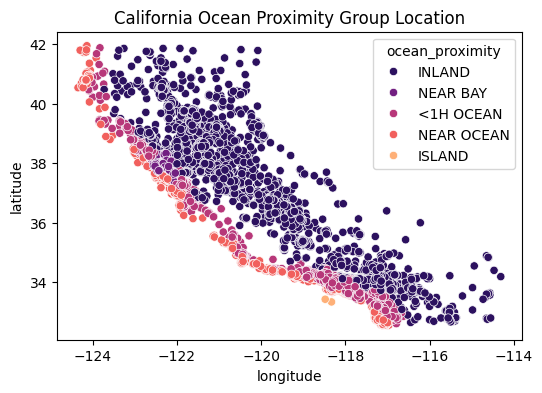

In [24]:
# Ocean Proximity Plot 
plt.figure(figsize=(6,4))  
sns.scatterplot(data=df, 
                x='longitude', 
                y='latitude', 
                hue='ocean_proximity', 
                palette="magma").set_title('California Ocean Proximity Group Location')  


Visualization of how close the housing / block is to the coast. Only two `ISLAND` data located in the dataset.

Text(0.5, 1.0, 'California Median House Value Group Location')

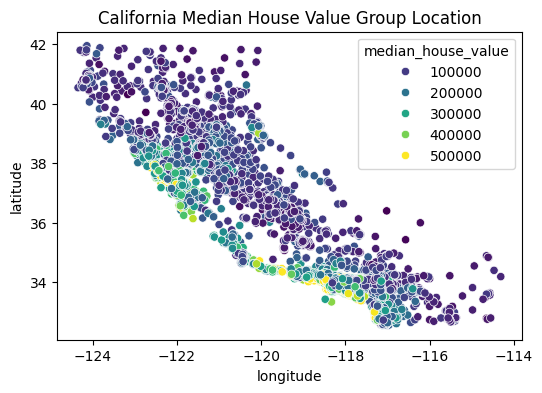

In [25]:
# Median House Value Plot
plt.figure(figsize=(6,4))
sns.scatterplot(x=df['longitude'], 
                y=df['latitude'],
                hue=df['median_house_value'],
                palette='viridis').set_title('California Median House Value Group Location')

The visualization above shows that the `median_house_value` is higher when the `ocean_proximity` is near the coast.

## 3. Ocean Proximity Histogram

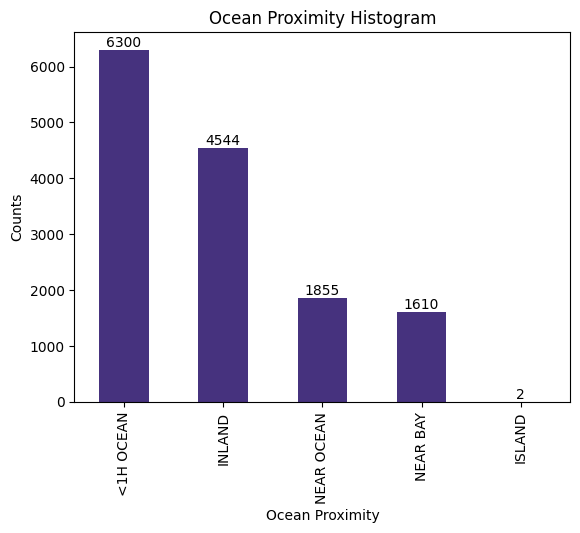

In [26]:
# Set the color palette to viridis
sns.set_palette('viridis')

# Create the histogram
counts = df['ocean_proximity'].value_counts()
ax = counts.plot(kind='bar')

# Add value labels on top of each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', 
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='bottom')

plt.title('Ocean Proximity Histogram')
plt.xlabel('Ocean Proximity')
plt.ylabel('Counts')
plt.show()

Most housing in this dataset is located near the coast. Only 2 located in the separate islands.

## 4. Data Summary (Adding Quartile)

In [27]:
  # Summary Function  
def summarize_numerical_features(df):  
    summary = {}  
    for column in df.select_dtypes(include=[np.number]).columns:  
        Q1 = df[column].quantile(0.25)  
        Q3 = df[column].quantile(0.75)  
        IQR = Q3 - Q1  
          
        # Calculate lower and upper bounds  
        lower_bound = Q1 - 1.5 * IQR  
        upper_bound = Q3 + 1.5 * IQR  
          
        # Adjust lower bound for non-negative features  
        if df[column].min() >= 0:  # Check if the feature is non-negative  
            lower_bound = max(lower_bound, 0)  # Set lower bound to 0 if it's negative  
          
        summary[column] = {  
            'min': df[column].min(),  
            'max': df[column].max(),  
            'mean': df[column].mean(),  
            'median': df[column].median(),  
            'mode': df[column].mode()[0],  
            'Q1': Q1,  
            'Q2': df[column].quantile(0.5),  
            'Q3': Q3,  
            'lower_bound': lower_bound,  
            'upper_bound': upper_bound  
        }  
    return pd.DataFrame(summary)  
  
# Example usage  
summary_df = summarize_numerical_features(df).T
summary_df  


,min,max,mean,median,mode,Q1,Q2,Q3,lower_bound,upper_bound
longitude,-124.350000,-114.310000,-119.567150,-118.490000,-118.310000,-121.800000,-118.490000,-118.000000,-127.500000,-112.300000
latitude,32.540000,41.950000,35.631365,34.260000,34.060000,33.930000,34.260000,37.715000,28.252500,43.392500
housing_median_age,1.000000,52.000000,28.609671,29.000000,52.000000,18.000000,29.000000,37.000000,0.000000,65.500000
total_rooms,2.000000,32627.000000,2640.917686,2125.000000,1582.000000,1452.000000,2125.000000,3142.000000,0.000000,5677.000000
total_bedrooms,1.000000,6445.000000,538.260709,435.000000,331.000000,295.000000,435.000000,647.000000,0.000000,1175.000000
population,3.000000,35682.000000,1424.772273,1164.000000,1227.000000,784.000000,1164.000000,1722.000000,0.000000,3129.000000
households,1.000000,6082.000000,499.480470,410.000000,335.000000,279.000000,410.000000,603.500000,0.000000,1090.250000
median_income,0.499900,15.000100,3.866774,3.540300,2.875000,2.569400,3.540300,4.736100,0.000000,7.986150
median_house_value,14999.000000,500001.000000,206793.156942,180000.000000,500001.000000,119400.000000,180000.000000,263750.000000,0.000000,480275.000000
room_per_household,0.846154,132.533333,5.425520,5.230769,5.000000,4.453362,5.230769,6.047714,2.061834,8.439242


## 5. Normality Test

In [28]:
# Selecting numeric columns  
numeric_cols = df.select_dtypes(include=['number']).columns  
  
# Initialize a list to store results  
results = []  
  
# Loop through each numeric column to check for normality  
for col in numeric_cols: 
    shapiro_stat, shapiro_p = stats.shapiro(df[col])   
    ks_stat, ks_p = stats.kstest(df[col], 'norm', args=(df[col].mean(), df[col].std())) 
    dagostino_stat, dagostino_p = stats.normaltest(df[col])  
      
    # Append results to the list with the feature name  
    results.append({  
        'Column': col,  
        'Test Name': 'Shapiro-Wilk',  
        'Normality': "Normal" if shapiro_p > 0.05 else "Not Normal"  
    })  
    results.append({  
        'Column': col,  
        'Test Name': 'Kolmogorov-Smirnov',  
        'Normality': "Normal" if ks_p > 0.05 else "Not Normal"  
    })  
    results.append({  
        'Column': col,  
        'Test Name': 'D\'Agostino\'s K^2',  
        'Normality': "Normal" if dagostino_p > 0.05 else "Not Normal"  
    })  

# Create Dataframe from the list 
normality_result = pd.DataFrame(results)  
normality_result = normality_result.pivot(index='Test Name', columns='Column', values='Normality')
normality_result  

c:\Users\MSKF\AppData\Local\Programs\Python\Python313\Lib\site-packages\scipy\stats\_axis_nan_policy.py:573: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 14311.
  res = hypotest_fun_out(*samples, **kwds)


Column,bedrooms_ratio,households,housing_median_age,income_household,income_level,latitude,longitude,median_house_value,median_income,population,population_per_household,room_per_household,total_bedrooms,total_rooms
Test Name,,,,,,,,,,,,,,
D'Agostino's K^2,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal
Kolmogorov-Smirnov,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal
Shapiro-Wilk,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal,Not Normal


All the numeric columns are not normally distributed.

## 6. Outliers

In [29]:
# Visual Distribution Fucntion
  
def visual_distribution(df, column):  
    plt.figure(figsize=(9, 4))  
  
    # Histogram  
    plt.subplot(1, 2, 1)  
    sns.histplot(df[column], kde=True)  
    plt.title(f'Histogram of {column}')  
    plt.xlabel(column)  
    plt.ylabel('Frequency')  
  
    # Box plot  
    plt.subplot(1, 2, 2)  
    sns.boxplot(x=df[column])  
    plt.title(f'Box Plot of {column}')  
    plt.xlabel(column)  
  
    plt.tight_layout()  
    plt.show()  

### a `housing_median_age`

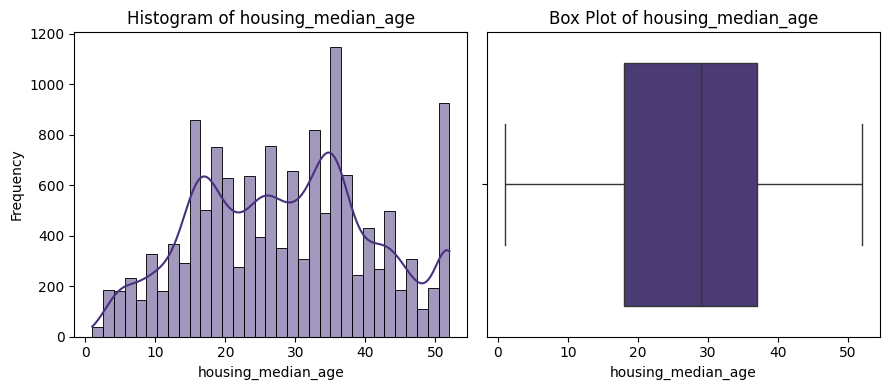

In [30]:
visual_distribution(df, "housing_median_age")

In [31]:
# Show Housing Median Age more than 50
df[df['housing_median_age'] > 50]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level
0,-119.79,36.73,52.0,112.0,28.0,193.0,40.0,1.9750,INLAND,47500.0,2.800000,4.825000,0.250000,0.049375,1
38,-121.95,37.28,52.0,777.0,148.0,362.0,144.0,4.0208,<1H OCEAN,262500.0,5.395833,2.513889,0.190476,0.027922,2
48,-122.43,37.71,52.0,1508.0,278.0,1138.0,304.0,4.0234,NEAR BAY,266500.0,4.960526,3.743421,0.184350,0.013235,2
50,-122.26,37.88,52.0,2363.0,604.0,1558.0,573.0,2.9440,NEAR BAY,338900.0,4.123909,2.719023,0.255607,0.005138,1
65,-122.25,37.84,52.0,3549.0,707.0,1551.0,714.0,3.6912,NEAR BAY,261100.0,4.970588,2.172269,0.199211,0.005170,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14331,-122.18,37.77,52.0,2744.0,547.0,1479.0,554.0,2.2768,NEAR BAY,96200.0,4.953069,2.669675,0.199344,0.004110,1
14353,-122.41,37.74,52.0,2058.0,399.0,1208.0,399.0,3.6429,NEAR BAY,230000.0,5.157895,3.027569,0.193878,0.009130,2
14378,-117.15,32.72,52.0,344.0,177.0,460.0,147.0,1.2292,NEAR OCEAN,137500.0,2.340136,3.129252,0.514535,0.008362,1
14424,-118.31,33.98,52.0,1837.0,426.0,1062.0,343.0,2.0000,<1H OCEAN,96500.0,5.355685,3.096210,0.231900,0.005831,1


### b. `total_rooms`

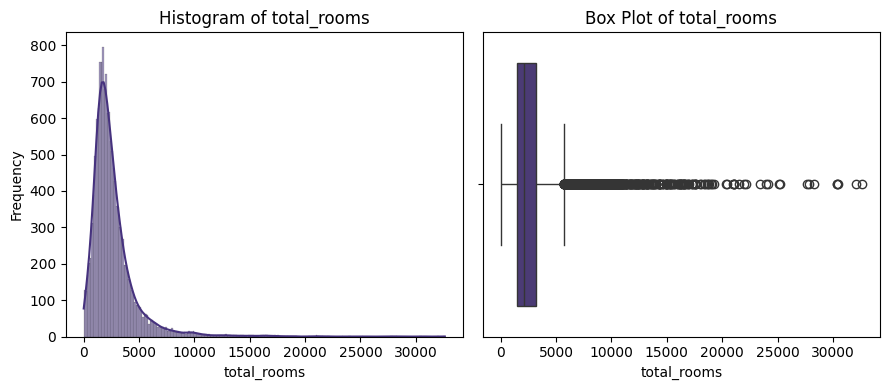

In [32]:
visual_distribution(df, "total_rooms")

The `total_rooms` has a right skew. Housing / blocks with more total rooms maybe indicate larger buildings area.

In [33]:
# Showing total_rooms more than 5000
df[df['total_rooms'] > 5000]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level
5,-117.79,33.80,11.0,10535.0,1620.0,4409.0,1622.0,6.6700,<1H OCEAN,283200.0,6.495068,2.718249,0.153773,0.004112,2
9,-122.27,37.97,10.0,15259.0,2275.0,7266.0,2338.0,6.0666,NEAR BAY,272400.0,6.526518,3.107784,0.149092,0.002595,2
13,-117.50,33.96,12.0,7923.0,1470.0,4861.0,1385.0,4.2985,INLAND,139200.0,5.720578,3.509747,0.185536,0.003104,2
22,-121.53,38.61,5.0,8149.0,1913.0,2933.0,1616.0,3.6788,INLAND,178800.0,5.042698,1.814975,0.234753,0.002276,2
28,-121.09,38.68,15.0,5218.0,711.0,1949.0,659.0,4.7083,INLAND,213300.0,7.918058,2.957511,0.136259,0.007145,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14406,-122.25,37.46,33.0,6841.0,950.0,2681.0,980.0,7.1088,NEAR OCEAN,443300.0,6.980612,2.735714,0.138869,0.007254,3
14413,-122.28,37.49,25.0,7335.0,1157.0,2626.0,1049.0,6.5475,NEAR OCEAN,500001.0,6.992374,2.503337,0.157737,0.006242,2
14417,-117.05,33.05,6.0,7916.0,1293.0,2741.0,1204.0,5.6436,<1H OCEAN,278600.0,6.574751,2.276578,0.163340,0.004687,2
14427,-118.03,34.01,10.0,6531.0,1036.0,2975.0,1018.0,6.2319,<1H OCEAN,403700.0,6.415521,2.922397,0.158628,0.006122,2


### c. `total_bedrooms`

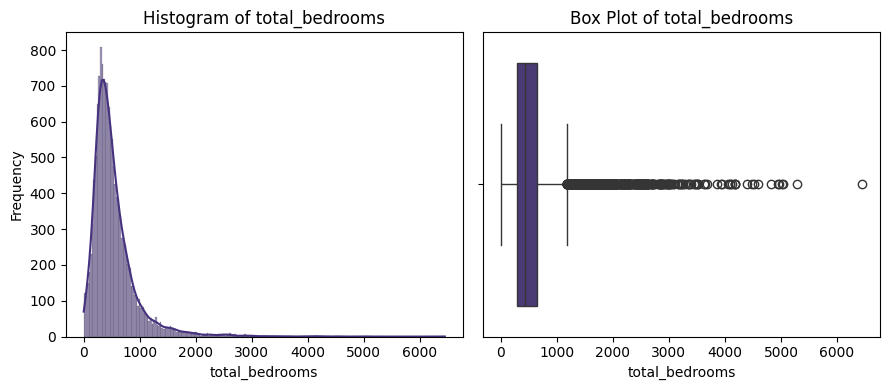

In [34]:
visual_distribution(df, "total_bedrooms")

`total_bedrooms` usually has a linear relationship with `total_rooms`. The chart show `total_bedrooms` has a right skew also.

In [35]:
# Showing total bedrooms more than 1500
df[df['total_bedrooms'] > 1500]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level
5,-117.79,33.80,11.0,10535.0,1620.0,4409.0,1622.0,6.6700,<1H OCEAN,283200.0,6.495068,2.718249,0.153773,0.004112,2
9,-122.27,37.97,10.0,15259.0,2275.0,7266.0,2338.0,6.0666,NEAR BAY,272400.0,6.526518,3.107784,0.149092,0.002595,2
22,-121.53,38.61,5.0,8149.0,1913.0,2933.0,1616.0,3.6788,INLAND,178800.0,5.042698,1.814975,0.234753,0.002276,2
54,-121.36,38.67,5.0,5819.0,1507.0,3237.0,1356.0,2.2339,INLAND,116600.0,4.291298,2.387168,0.258979,0.001647,1
77,-122.05,37.93,15.0,7803.0,1603.0,2957.0,1546.0,4.4500,NEAR BAY,184900.0,5.047219,1.912678,0.205434,0.002878,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14299,-117.92,33.67,14.0,6224.0,1679.0,3148.0,1589.0,4.2071,<1H OCEAN,430900.0,3.916929,1.981120,0.269762,0.002648,2
14326,-118.34,33.91,12.0,9975.0,3638.0,7429.0,3405.0,2.6689,<1H OCEAN,192300.0,2.929515,2.181791,0.364712,0.000784,1
14343,-118.09,34.57,4.0,9761.0,1683.0,4970.0,1535.0,4.5266,INLAND,142900.0,6.358958,3.237785,0.172421,0.002949,2
14362,-117.22,32.86,4.0,16289.0,4585.0,7604.0,4176.0,3.6287,NEAR OCEAN,280800.0,3.900623,1.820881,0.281478,0.000869,2


### d. `population`

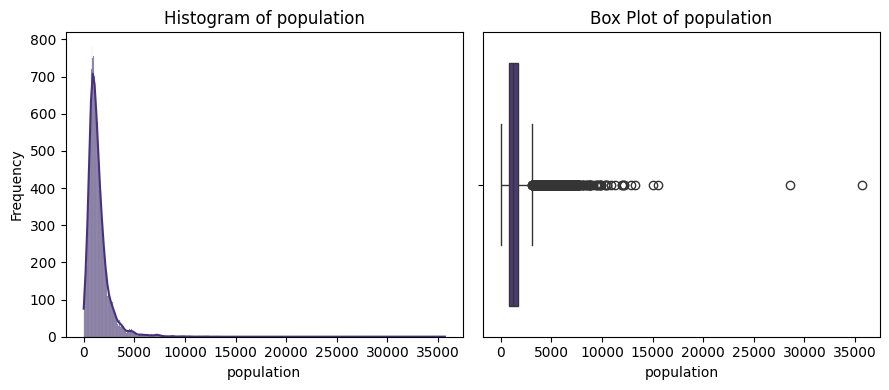

In [36]:
visual_distribution(df, "population")

More population suggests more households and more total rooms.

In [37]:
# Showing population more than 10000
df[df['population'] > 10000].sort_values(by='population', ascending=False)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level
12511,-117.42,33.35,14.0,25135.0,4819.0,35682.0,4769.0,2.5729,<1H OCEAN,134400.0,5.270497,7.482072,0.191725,0.000540,1
4124,-121.79,36.64,11.0,32627.0,6445.0,28566.0,6082.0,2.3087,<1H OCEAN,118800.0,5.364518,4.696810,0.197536,0.000380,1
8061,-117.78,34.03,8.0,32054.0,5290.0,15507.0,5050.0,6.0191,<1H OCEAN,253900.0,6.347327,3.070693,0.165034,0.001192,2
12657,-117.87,34.04,7.0,27700.0,4179.0,15037.0,4072.0,6.6288,<1H OCEAN,339700.0,6.802554,3.692780,0.150866,0.001628,2
13215,-117.12,33.52,4.0,30401.0,4957.0,13251.0,4339.0,4.5841,<1H OCEAN,212300.0,7.006453,3.053929,0.163054,0.001056,2
12079,-118.78,34.16,9.0,30405.0,4093.0,12873.0,3931.0,8.0137,NEAR OCEAN,399200.0,7.734673,3.274739,0.134616,0.002039,3
11231,-121.92,37.53,7.0,28258.0,3864.0,12203.0,3701.0,8.4045,<1H OCEAN,451100.0,7.635234,3.297217,0.136740,0.002271,3
14295,-121.68,36.72,12.0,19234.0,4492.0,12153.0,4372.0,3.2652,<1H OCEAN,152800.0,4.399360,2.779735,0.233545,0.000747,2
167,-118.90,34.26,5.0,25187.0,3521.0,11956.0,3478.0,6.9712,<1H OCEAN,321300.0,7.241806,3.437608,0.139794,0.002004,2
10900,-121.53,38.48,5.0,27870.0,5027.0,11935.0,4855.0,4.8811,INLAND,212200.0,5.740474,2.458290,0.180373,0.001005,2


### e. `households`

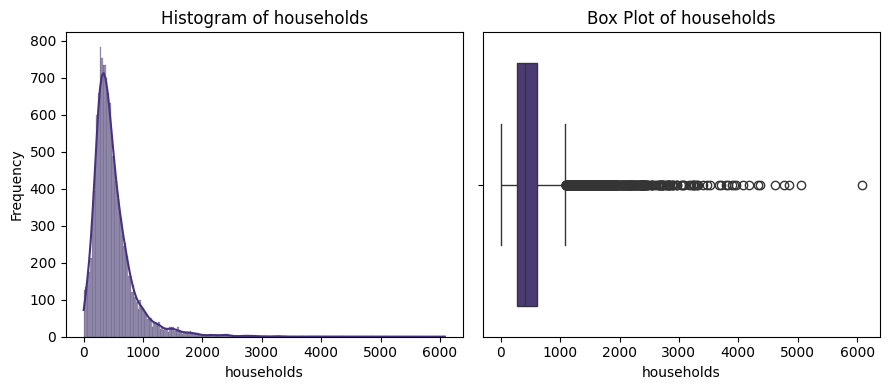

In [38]:
visual_distribution(df, "households")

In [39]:
# Showing households more than 1000
df[df['households'] > 1000].sort_values(by='households', ascending=False).head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level
4124,-121.79,36.64,11.0,32627.0,6445.0,28566.0,6082.0,2.3087,<1H OCEAN,118800.0,5.364518,4.696810,0.197536,0.000380,1
8061,-117.78,34.03,8.0,32054.0,5290.0,15507.0,5050.0,6.0191,<1H OCEAN,253900.0,6.347327,3.070693,0.165034,0.001192,2
10900,-121.53,38.48,5.0,27870.0,5027.0,11935.0,4855.0,4.8811,INLAND,212200.0,5.740474,2.458290,0.180373,0.001005,2
12511,-117.42,33.35,14.0,25135.0,4819.0,35682.0,4769.0,2.5729,<1H OCEAN,134400.0,5.270497,7.482072,0.191725,0.000540,1
9809,-117.34,33.98,10.0,17286.0,4952.0,9851.0,4616.0,1.7579,INLAND,103400.0,3.744801,2.134099,0.286475,0.000381,1


### f. `median_income`

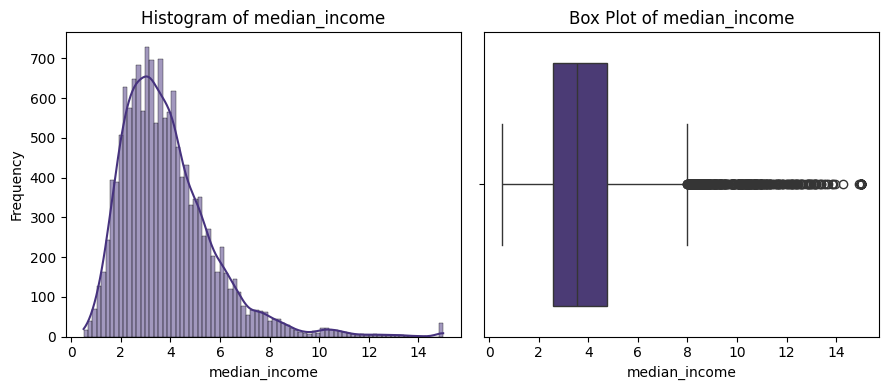

In [40]:
visual_distribution(df, "median_income")

In [41]:
# Showing median income more than 8
df[df['median_income'] > 8]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level
6,-117.80,33.81,14.0,1206.0,142.0,572.0,149.0,8.8470,<1H OCEAN,388700.0,8.093960,3.838926,0.117745,0.059376,3
8,-117.65,33.48,6.0,1638.0,188.0,572.0,174.0,13.0502,<1H OCEAN,500001.0,9.413793,3.287356,0.114774,0.075001,3
43,-122.21,37.37,34.0,1476.0,217.0,613.0,223.0,8.2883,NEAR OCEAN,500001.0,6.618834,2.748879,0.147019,0.037167,3
73,-121.99,37.26,17.0,4034.0,611.0,1158.0,560.0,8.2069,<1H OCEAN,442500.0,7.203571,2.067857,0.151463,0.014655,3
124,-121.89,37.23,20.0,7754.0,976.0,3094.0,941.0,8.1900,<1H OCEAN,361600.0,8.240170,3.287991,0.125871,0.008704,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14298,-118.54,34.26,23.0,4960.0,592.0,1929.0,586.0,10.9052,<1H OCEAN,500001.0,8.464164,3.291809,0.119355,0.018610,3
14306,-118.18,34.16,34.0,5012.0,746.0,1699.0,715.0,9.4987,<1H OCEAN,500001.0,7.009790,2.376224,0.148843,0.013285,3
14314,-118.01,33.69,3.0,945.0,115.0,337.0,123.0,11.5199,<1H OCEAN,500001.0,7.682927,2.739837,0.121693,0.093658,3
14346,-117.66,34.12,22.0,2272.0,278.0,933.0,305.0,8.8204,INLAND,390500.0,7.449180,3.059016,0.122359,0.028919,3


### g. `median_house_value`

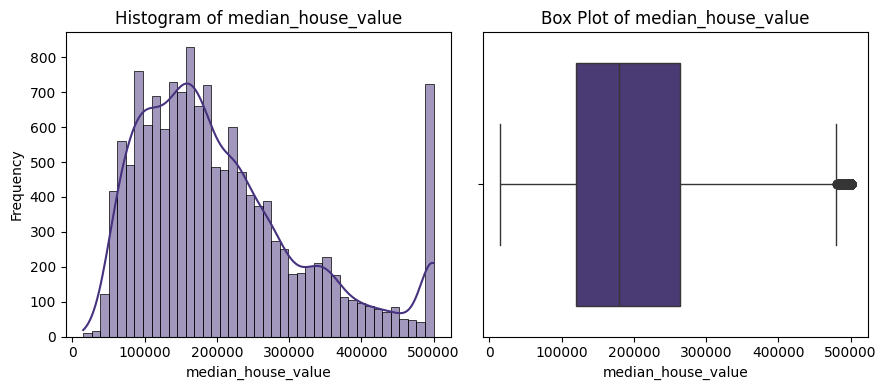

In [42]:
visual_distribution(df, "median_house_value")

In [43]:
# Showing house value more than 475000
high_price = df[df['median_house_value'] > 500000]
high_price

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level
8,-117.65,33.48,6.0,1638.0,188.0,572.0,174.0,13.0502,<1H OCEAN,500001.0,9.413793,3.287356,0.114774,0.075001,3
43,-122.21,37.37,34.0,1476.0,217.0,613.0,223.0,8.2883,NEAR OCEAN,500001.0,6.618834,2.748879,0.147019,0.037167,3
133,-122.44,37.80,52.0,3257.0,735.0,1045.0,620.0,4.5523,NEAR BAY,500001.0,5.253226,1.685484,0.225668,0.007342,2
201,-122.42,37.80,52.0,4079.0,1112.0,1466.0,1024.0,4.5913,NEAR BAY,500001.0,3.983398,1.431641,0.272616,0.004484,2
236,-121.89,37.46,5.0,1519.0,186.0,705.0,186.0,10.3798,<1H OCEAN,500001.0,8.166667,3.790323,0.122449,0.055805,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14325,-118.44,34.07,26.0,3535.0,748.0,1322.0,666.0,7.1674,<1H OCEAN,500001.0,5.307808,1.984985,0.211598,0.010762,3
14328,-118.46,34.06,46.0,1302.0,215.0,482.0,226.0,7.0674,<1H OCEAN,500001.0,5.761062,2.132743,0.165131,0.031272,3
14371,-122.02,37.29,18.0,2550.0,312.0,999.0,320.0,8.7939,<1H OCEAN,500001.0,7.968750,3.121875,0.122353,0.027481,3
14377,-118.46,34.08,35.0,3247.0,525.0,1065.0,484.0,7.8426,<1H OCEAN,500001.0,6.708678,2.200413,0.161688,0.016204,3


<Axes: xlabel='ocean_proximity'>

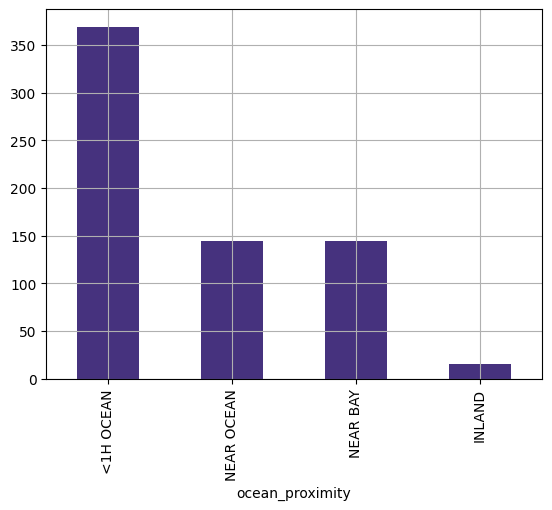

In [44]:
# Showing high_price bar chart by `ocean_proximity`
high_price['ocean_proximity'].value_counts().plot(kind='bar', grid=True)

### h. `population_per_household`

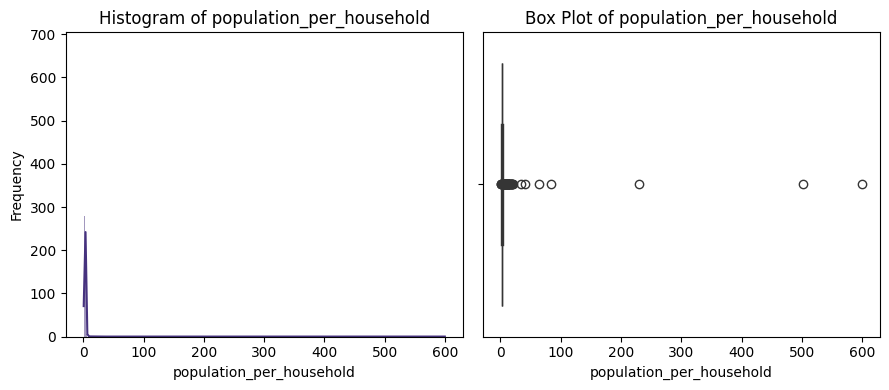

In [45]:
visual_distribution(df, "population_per_household")

In [46]:
# Show df when `population_per_household` is more than 50
df[df['population_per_household'] > 50]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level
2583,-120.70,35.32,46.0,118.0,17.0,6532.0,13.0,4.2639,NEAR OCEAN,350000.0,9.076923,502.461538,0.144068,0.327992,2
3513,-117.33,33.97,8.0,152.0,19.0,1275.0,20.0,1.6250,INLAND,162500.0,7.600000,63.750000,0.125000,0.081250,1
5419,-121.15,38.69,52.0,240.0,44.0,6675.0,29.0,6.1359,INLAND,225000.0,8.275862,230.172414,0.183333,0.211583,2
7509,-118.59,34.47,5.0,538.0,98.0,8733.0,105.0,4.2391,INLAND,154600.0,5.123810,83.171429,0.182156,0.040372,2
7974,-120.51,40.41,36.0,36.0,8.0,4198.0,7.0,5.5179,INLAND,67500.0,5.142857,599.714286,0.222222,0.788271,2


### i. `room_per_household`

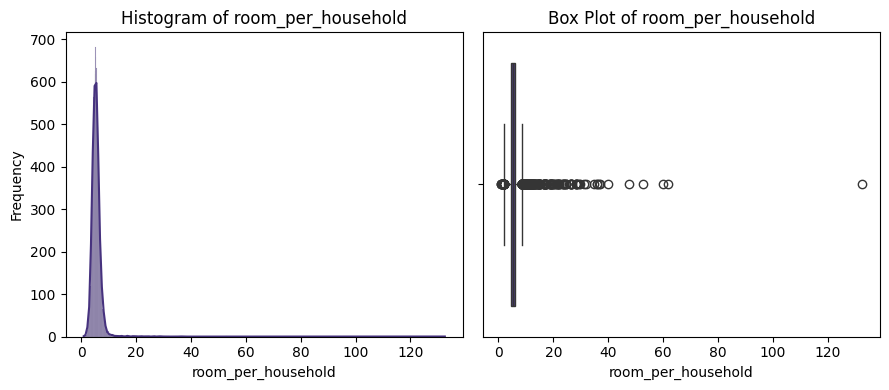

In [47]:
visual_distribution(df, "room_per_household")

The right-skewed nature of the distribution indicates that while most households have a low number of rooms, there are a few with a high number of rooms. This disparity can imply that many properties are not fully utilized or are vacant.

### j. `bedrooms_ratio`

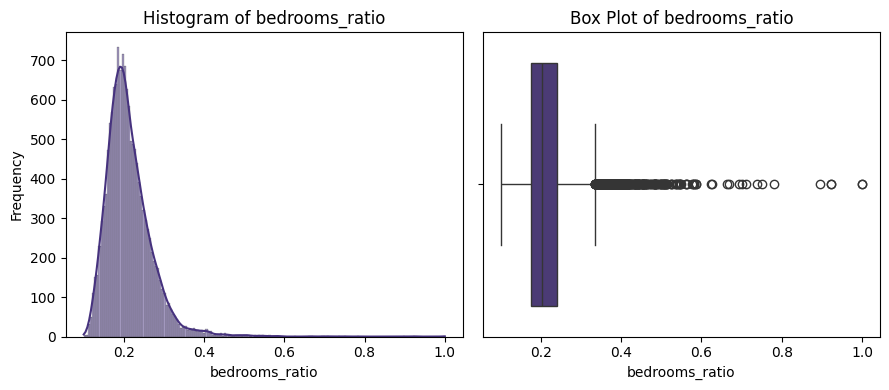

In [48]:
visual_distribution(df, "bedrooms_ratio")

### k. `income_household`

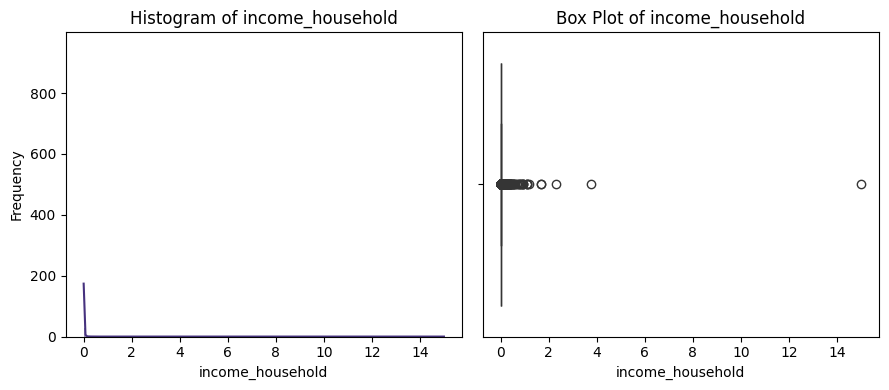

In [49]:
visual_distribution(df, "income_household")

### l. `income_level`

<Axes: xlabel='income_level'>

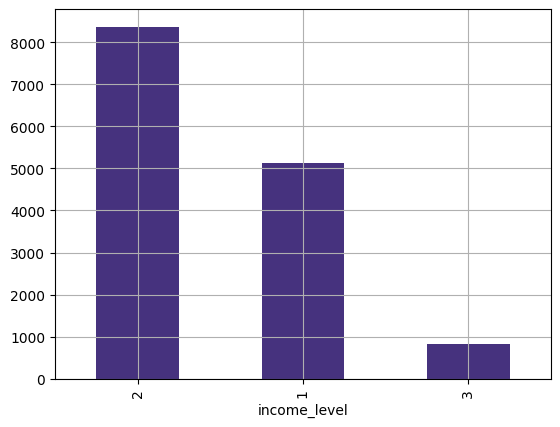

In [50]:
# showing bar plot for income_level
df['income_level'].value_counts().plot(kind='bar', grid=True)

Majority of the data are in **average** income level. Their purchasing level maybe is not better than the high income level. Higher income tends to have higher median house value.

## 7. Correlation

Correlation can be used to determine whether there is a relationship between two variables. Here, we will use the Spearman's correlation coefficient to measure the correlation between each pair of variables because the data is not normally distributed.

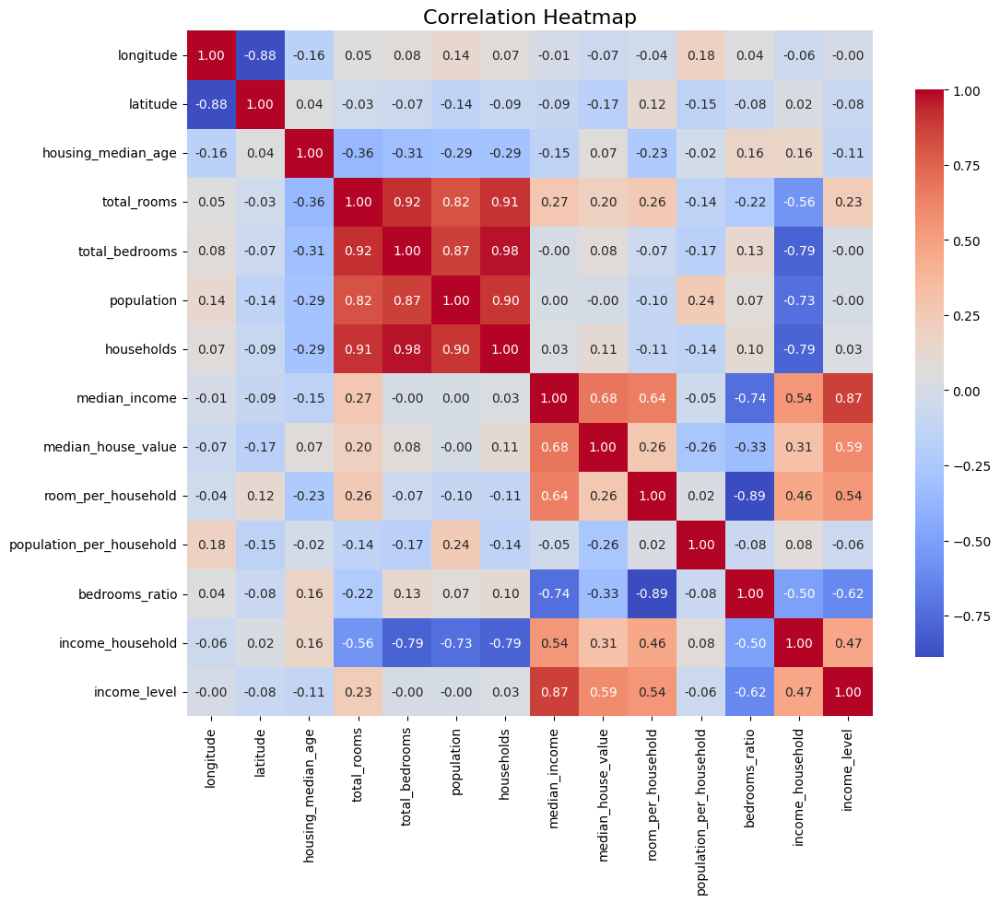

In [51]:
# calculate correlation matrix
df_corr = df[numeric_cols].corr(method="spearman")

# display correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(df_corr, annot=True, fmt=".2f", cmap='coolwarm', square=True, cbar_kws={"shrink": .8})  
  
plt.title('Correlation Heatmap', fontsize=16)
plt.show() 


Key Observations from the Correlation Matrix  
  
1. **Strong Positive Correlations**:  
   - `median_income` and `median_house_value` (0.68): Higher income correlates with higher house values.  
   - `total_rooms` and `total_bedrooms` (0.91): More rooms are associated with more bedrooms.  
  
2. **Moderate Positive Correlations**:  
   - `median_house_value` and `total_rooms` (0.64): More rooms may lead to higher house values.  
   - `population` and `households` (0.98): More population typically means more households.  
  
3. **Negative Correlations**:  
   - `housing_median_age` and `median_house_value` (-0.17): Older houses may have lower values.  
   - `bedrooms_ratio` and `median_house_value` (-0.74): A higher ratio of bedrooms to total rooms correlates with lower house values.  
  
4. **Weak Correlations**:  
   - `income_level` and `median_house_value` (0.47): Moderate positive relationship, suggesting higher income levels may relate to higher house values.  
  


**Model Selection and Training**

Given that we're predicting a continuous numerical value (`median_house_value`), regression algorithms like Linear Regression, Random Forest, or XGBoost are suitable choices. And we can try another model like Decision Tree also.

Mean Absolute Error (MAE), Mean Squared Error (MSE), Root Mean Squared Error (RMSE), or R-squared can be used to evaluate the model's performance.

## 8. Multicolinearity

In [52]:
# Check multicollinearity with VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor

def calculate_vif(df):
    vif = pd.DataFrame()
    vif["Features"] = df.columns
    vif["VIF"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
    return vif

# Calculate VIF
vif_table = calculate_vif(df[numeric_cols])
vif_table

,Features,VIF
0,longitude,818.645354
1,latitude,599.855322
2,housing_median_age,7.892557
3,total_rooms,44.274017
4,total_bedrooms,124.299601
5,population,17.915743
6,households,117.993599
7,median_income,27.303855
8,median_house_value,10.415793
9,room_per_household,12.029934


 Observations on Multicollinearity in the California Housing Price Dataset   
  
- Critical Issues: `longitude` and `latitude` show extremely high VIF values, indicating severe multicollinearity.
- Moderate Concerns: Features like `total_rooms`, `total_bedrooms`, `households`, and `median_income` also exhibit high VIF values, suggesting potential issues in regression analysis.
- Low Multicollinearity: Features such as `population_per_household` have low VIF values, indicating they are less affected by multicollinearity.
  
Conclusion:  
  
- The dataset exhibits significant multicollinearity, particularly with `longitude`, `latitude`, `total_bedrooms`, and `households`.  
- To address this multicollinearity, some ways can be done : feature selection, dimensionality reduction, or regularization techniques, to improve model performance and interpretability.  
- Careful consideration should be given to the inclusion of highly collinear features in predictive models, as they can inflate standard errors and lead to unreliable coefficient estimates.
- The other way to address multicollinearity is by using Tree based models like **Random Forest or XGBoost, which are good at handling multicollinearity.** Another model that tree based are Decision Tree, etc.


# D. BASE MODEL

I try to use 8 models without cleaning the outliers first. The model are :

1. Linear Regression
2. Decision Tree
3. KNN
4. Random Forest
5. Gradient Boosting
6. XGBoost (Xtra Gradient Boosting)
7. Support Vector Machine
8. LightGBM (Light Gradient Boosting Machine)

## 1. Data Split

In [53]:
X = df.drop('median_house_value', axis=1)
y = df['median_house_value']

X_train, X_test, y_train, y_test = train_test_split(
    X, 
    y, 
    test_size=0.2, 
    random_state=42
)

In [54]:
numerical_features = X.select_dtypes(include=["number"]).columns
categorical_features = X.select_dtypes(include=['object']).columns

## 2. Preprocessor

In [55]:
preprocessor = ColumnTransformer(  
    transformers=[  
        ('num', RobustScaler(), numerical_features),  
        ('cat', OneHotEncoder(drop='first'), categorical_features)  
    ])

## 3. Models

In [56]:
models = {    
    "Linear Regression": LinearRegression(),    
    "Decision Tree": DecisionTreeRegressor(random_state=42),    
    "KNN": KNeighborsRegressor(),    
    "Random Forest": RandomForestRegressor(random_state=42),    
    "Gradient Boosting": GradientBoostingRegressor(random_state=42),    
    "XGBoost": XGBRegressor(random_state=42),    
    "Support Vector Regression": SVR(kernel='rbf'),           
    "LightGBM": LGBMRegressor(random_state=42, force_col_wise=True) 
} 

## 4. Cross Validation

In [57]:
results = {}    

# Define custom scorers    
scorers = {    
    'MAE': make_scorer(mean_absolute_error, greater_is_better=False),    
    'MSE': make_scorer(mean_squared_error, greater_is_better=False),    
    'RMSE': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False),    
    'R²': make_scorer(r2_score)    
}    

# Loop through each model    
for model_name, model in models.items():    
    # Create a pipeline with preprocessing and the model    
    pipeline = Pipeline(steps=[('preprocessor', preprocessor),    
                               ('model', model)])    

    # Perform cross-validation on training data  
    cv_results = {metric: cross_val_score(pipeline, X_train, y_train, cv=5, scoring=scorer).mean()    
                  for metric, scorer in scorers.items()}    

    # Store the cross-validation results  
    results[model_name] = {    
        'CV MAE': -cv_results['MAE'],    
        'CV MSE': -cv_results['MSE'],    
        'CV RMSE': -cv_results['RMSE'],    
        'CV R²': cv_results['R²']  
    }    

# Convert results to a DataFrame  
cv_results_df = pd.DataFrame(results).T    
cv_results_df = cv_results_df.sort_values(by='CV RMSE', ascending=True)     
cv_results_df

[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 9158, number of used features: 16
[LightGBM] [Info] Start training from score 207052.135401
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 9158, number of used features: 16
[LightGBM] [Info] Start training from score 206418.862088
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 9158, number of used features: 16
[LightGBM] [Info] Start training from score 206880.764031
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 9159, number of used features: 16
[LightGBM] [Info] Start training from score 208058.790698
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 9159, number of used features: 16
[LightGBM] [Info] Start training from score 207429.319795
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the

,CV MAE,CV MSE,CV RMSE,CV R²
LightGBM,31281.042076,2.229883e+09,47212.518446,0.834727
XGBoost,32277.049032,2.401054e+09,48997.669738,0.822266
Random Forest,34093.603139,2.678477e+09,51751.711900,0.801703
Gradient Boosting,36868.517689,2.834283e+09,53234.354017,0.790159
KNN,43192.153399,3.949099e+09,62835.838804,0.707835
Linear Regression,49251.540157,4.706338e+09,68596.569651,0.651610
Decision Tree,48029.637895,5.507809e+09,74200.618467,0.592072
Support Vector Regression,89059.427922,1.427470e+10,119442.099461,-0.054602


From the results we get the 3 best models are :
  1. LightGBM
  2. XGBoost
  3. Random Forest

Then i want to try those 3 models with cleaning the X_train outliers first.

# E. OUTLIERS DELETE - EXPERIMENTATION

## 1. CV - IQR Outliers Cleaning

In [58]:
# Improved IQR outlier removal function
def remove_outliers_iqr(data, numerical_features):  
    Q1 = data[numerical_features].quantile(0.25)  
    Q3 = data[numerical_features].quantile(0.75)  
    IQR = Q3 - Q1  
    lower_bound = Q1 - 1.5 * IQR  
    upper_bound = Q3 + 1.5 * IQR  
    
    mask = ~((data[numerical_features] < lower_bound) | (data[numerical_features] > upper_bound)).any(axis=1)
    return data[mask], mask

# Improved cross-validation function
def perform_cross_validation(X_train, y_train, models, preprocessor):  
    results = {}  
    scorers = {  
        'MAE': make_scorer(mean_absolute_error, greater_is_better=False),  
        'MSE': make_scorer(mean_squared_error, greater_is_better=False),  
        'RMSE': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False),  
        'R²': make_scorer(r2_score)  
    }  
    # KFold for reproducibility
    cv = KFold(n_splits=5, shuffle=True, random_state=42)
    
    for model_name, model in models.items():  
        pipeline = Pipeline(steps=[('preprocessor', preprocessor), ('model', model)])  
        
        # Cross-validation on training data  
        cv_results = {metric: cross_val_score(pipeline, X_train, y_train, cv=cv, scoring=scorer).mean() for metric, scorer in scorers.items()}  
        
        # Store the cross-validation results  
        results[model_name] = {  
            'CV MAE': -cv_results['MAE'],  
            'CV MSE': -cv_results['MSE'],  
            'CV RMSE': -cv_results['RMSE'],  
            'CV R²': cv_results['R²'],  
        }  
    
    return pd.DataFrame(results).T.sort_values(by='CV RMSE', ascending=True)  

# Preprocessing pipeline
preprocessor = ColumnTransformer(    
    transformers=[    
        ('num', RobustScaler(), numerical_features),    
        ('cat', OneHotEncoder(drop='first'), categorical_features)    
    ])  

# Selected models
selected_models = {
    "LightGBM": LGBMRegressor(random_state=42, force_col_wise=True),
    "XGBoost": XGBRegressor(random_state=42),
    "Random Forest": RandomForestRegressor(random_state=42)
}

# Remove outliers with IQR
X_train_iqr_filtered, iqr_mask = remove_outliers_iqr(X_train, numerical_features)
y_train_iqr_filtered = y_train.loc[iqr_mask]

# Ensure filtered data is not empty
if X_train_iqr_filtered.empty:
    raise ValueError("No data left after IQR filtering. Adjust the filtering criteria.")

# Cross-validation with IQR filtered data
cv_results_iqr = perform_cross_validation(X_train_iqr_filtered, y_train_iqr_filtered, selected_models, preprocessor)

# Create a table for easy reference
table = cv_results_iqr.reset_index()
table.rename(columns={'index': 'Model Name'}, inplace=True)

# Print cross-validation results and formatted table
print("Cross-validation results after IQR outlier removal:")
print(cv_results_iqr)

print("\nFormatted Table:")
print(table)

# Displaying the table as a DataFrame
table

[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 7031, number of used features: 16
[LightGBM] [Info] Start training from score 194638.766036
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 7031, number of used features: 16
[LightGBM] [Info] Start training from score 194643.091737
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 7031, number of used features: 16
[LightGBM] [Info] Start training from score 195161.694069
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 7031, number of used features: 16
[LightGBM] [Info] Start training from score 196634.145499
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 7032, number of used features: 16
[LightGBM] [Info] Start training from score 196388.165245
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the

,Model Name,CV MAE,CV MSE,CV RMSE,CV R²
0,LightGBM,29025.947444,1.828961e+09,42740.096833,0.837368
1,XGBoost,29893.630190,1.946504e+09,44090.867301,0.827007
2,Random Forest,32467.415531,2.317131e+09,48117.525915,0.793784


LightGBM model showing the best results.

## 2. CV - Isolation Forest Cleaning

From the experimentation, we can see that the XGBoost model performs best after removing outliers using Isolation Forest.

In [59]:
# Improved Isolation Forest outlier removal function
def remove_outliers_isolation_forest(data, numerical_features):  
    isolation_forest = IsolationForest(contamination=0.05, random_state=42)  
    preds = isolation_forest.fit_predict(data[numerical_features])  
    mask = preds == 1  # Keep only inliers
    return data[mask], mask

# Improved cross-validation function
def perform_cross_validation(X_train, y_train, models, preprocessor):  
    results = {}  
    scorers = {  
        'MAE': make_scorer(mean_absolute_error, greater_is_better=False),  
        'MSE': make_scorer(mean_squared_error, greater_is_better=False),  
        'RMSE': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False),  
        'R²': make_scorer(r2_score)  
    }  
    # KFold for reproducibility
    cv = KFold(n_splits=5, shuffle=True, random_state=42)
    
    for model_name, model in models.items():  
        pipeline = Pipeline(steps=[('preprocessor', preprocessor), ('model', model)])  
        
        # Cross-validation on training data  
        cv_results = {metric: cross_val_score(pipeline, X_train, y_train, cv=cv, scoring=scorer).mean() for metric, scorer in scorers.items()}  
        
        # Store the cross-validation results  
        results[model_name] = {  
            'CV MAE': -cv_results['MAE'],  
            'CV MSE': -cv_results['MSE'],  
            'CV RMSE': -cv_results['RMSE'],  
            'CV R²': cv_results['R²'],  
        }  
    
    return pd.DataFrame(results).T.sort_values(by='CV RMSE', ascending=True)  

# Preprocessing pipeline
preprocessor = ColumnTransformer(    
    transformers=[    
        ('num', RobustScaler(), numerical_features),    
        ('cat', OneHotEncoder(drop='first'), categorical_features)    
    ])  

# Selected models
selected_models = {
    "LightGBM": LGBMRegressor(random_state=42, force_col_wise=True),
    "XGBoost": XGBRegressor(random_state=42),
    "Random Forest": RandomForestRegressor(random_state=42)
}

# Remove outliers with Isolation Forest
X_train_if_filtered, if_mask = remove_outliers_isolation_forest(X_train, numerical_features)
y_train_if_filtered = y_train.loc[if_mask]

# Ensure filtered data is not empty
if X_train_if_filtered.empty:
    raise ValueError("No data left after Isolation Forest filtering. Adjust the filtering criteria.")

# Cross-validation with Isolation Forest filtered data
cv_results_if = perform_cross_validation(X_train_if_filtered, y_train_if_filtered, selected_models, preprocessor)

# Create a table for easy reference
table = cv_results_if.reset_index()
table.rename(columns={'index': 'Model Name'}, inplace=True)

# Print cross-validation results and formatted table
print("Cross-validation results after Isolation Forest outlier removal:")
print(cv_results_if)

print("\nFormatted Table:")
print(table)

# Displaying the table as a DataFrame
table

[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 8700, number of used features: 16
[LightGBM] [Info] Start training from score 204457.066322
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 8700, number of used features: 16
[LightGBM] [Info] Start training from score 204322.455517
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 8700, number of used features: 16
[LightGBM] [Info] Start training from score 203984.536322
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 8700, number of used features: 16
[LightGBM] [Info] Start training from score 203983.951149
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 8700, number of used features: 16
[LightGBM] [Info] Start training from score 204174.042184
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the

,Model Name,CV MAE,CV MSE,CV RMSE,CV R²
0,LightGBM,30829.893152,2.141631e+09,46261.405680,0.834279
1,XGBoost,31762.716509,2.256737e+09,47495.089349,0.825321
2,Random Forest,33886.785185,2.563417e+09,50608.831830,0.801674


After running 2 cleaning methode. IQR give best result.

# F. HYPERPARAMETER TUNING

## 1. LightGBM - GridSearch CV

In [60]:
# Custom scorer definitions
def mse(y_true, y_pred):
    return mean_squared_error(y_true, y_pred)

def mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

# Custom scorers for GridSearchCV
mse_scorer = make_scorer(mse, greater_is_better=False)
mae_scorer = make_scorer(mae, greater_is_better=False)
rmse_scorer = make_scorer(rmse, greater_is_better=False)
r2_scorer = make_scorer(r2_score, greater_is_better=True)

# Scoring dictionary with only positive metrics
scoring = {
    "mse": mse_scorer,  # Minimizing MSE
    "mae": mae_scorer,  # Minimizing MAE
    "rmse": rmse_scorer,  # Minimizing RMSE
    "r2": r2_scorer  # Maximizing R²
}

# Define the parameter grid for LightGBM
param_grid = {
    'model__n_estimators': [100, 200, 300],
    'model__learning_rate': [0.01, 0.1, 0.2],
    'model__max_depth': [-1, 5, 10],
    'model__num_leaves': [31, 50, 100],
    'model__subsample': [0.8, 1.0],
    'model__colsample_bytree': [0.8, 1.0]
}

# Create the LightGBM model
lgbm_model = LGBMRegressor(random_state=42, force_col_wise=True)

# Create a pipeline with the preprocessor and the model
pipeline = Pipeline(steps=[('preprocessor', preprocessor), ('model', lgbm_model)])

# Set up Grid Search
grid_search = GridSearchCV(
    pipeline,
    param_grid,
    scoring=scoring,  # Evaluate multiple metrics
    refit="rmse",  # Select the best model based on RMSE
    cv=5,
    verbose=1,
    n_jobs=-1,
    return_train_score=True,
)

# Fit the model with Grid Search
grid_search.fit(X_train_iqr_filtered, y_train_iqr_filtered)

# Extract and format the results
cv_results = pd.DataFrame(grid_search.cv_results_)
cv_results = cv_results.sort_values("mean_test_rmse", ascending=True)
cv_results

# Display the best parameters and the sorted results
print("Best Parameters:", grid_search.best_params_)

# Extracting metrics for the best parameters
best_index = grid_search.best_index_  # Index of the best parameter combination

# Create a DataFrame for the best results
best_results = pd.DataFrame({
    "CV MAE": [-cv_results.loc[best_index, "mean_test_mae"]],  # Flip sign to get positive value
    "CV MSE": [-cv_results.loc[best_index, "mean_test_mse"]],  # Flip sign to get positive value
    "CV RMSE": [-cv_results.loc[best_index, "mean_test_rmse"]],  # Flip sign to get positive value
    "CV R²": [cv_results.loc[best_index, "mean_test_r2"]],
})

# Display the best parameters and the summary table
print("\nSummary of Best Results:")
best_results

Fitting 5 folds for each of 324 candidates, totalling 1620 fits
[LightGBM] [Info] Total Bins 2865
[LightGBM] [Info] Number of data points in the train set: 8789, number of used features: 16
[LightGBM] [Info] Start training from score 195493.197975
Best Parameters: {'model__colsample_bytree': 0.8, 'model__learning_rate': 0.1, 'model__max_depth': -1, 'model__n_estimators': 300, 'model__num_leaves': 31, 'model__subsample': 0.8}

Summary of Best Results:


,CV MAE,CV MSE,CV RMSE,CV R²
0,28144.98006,1.751618e+09,41834.384136,0.844431


After performing hyper parameter tunning. The best parameter is :

- model__colsample_bytree : 0.8
- model__learning_rate : 0.1
- model__max_depth : -1
- model__n_estimators : 300
- model__num_leaves : 31
- model__subsample : 0.8

In [61]:
# Test the best parameters on the test set
y_pred = grid_search.predict(X_test)

# G. FEATURES IMPORTANCE




## 1. Features Importance

In [62]:
# Extract the best model from GridSearchCV
best_model = grid_search.best_estimator_ 

# Extract feature importance
# Access the LightGBM model from the pipeline
lgbm_best = best_model.named_steps['model']
feature_importances = lgbm_best.feature_importances_

# Assuming 'preprocessor' is a ColumnTransformer, get feature names
feature_names = best_model.named_steps['preprocessor'].get_feature_names_out()
feature_importance_df = pd.DataFrame({
    "Feature": feature_names,
    "Importance": feature_importances
}).sort_values(by="Importance", ascending=False)

# Display the feature importance
feature_importance_df

,Feature,Importance
1,num__latitude,1350
0,num__longitude,1330
9,num__population_per_household,1045
7,num__median_income,780
10,num__bedrooms_ratio,721
8,num__room_per_household,699
2,num__housing_median_age,647
11,num__income_household,488
5,num__population,486
6,num__households,419


The feature importance from the LightGBM model highlights which variables significantly influence the prediction of median house values:

1. **Latitude and Longitude** (`num__latitude`, `num__longitude`):
   - The most critical features, indicating strong spatial dependence of house values.

2. **Population Per Household** (`num__population_per_household`):
   - Ranks third, reflecting the importance of population density and household size in housing value prediction.

3. **Median Income** (`num__median_income`):
   - A major driver, showing the direct relationship between income levels and housing prices.

4. **Bedroom Ratio and Room Per Household** (`num__bedrooms_ratio`, `num__room_per_household`):
   - Significantly influence house values, highlighting housing composition as a key factor.

5. **Housing Median Age** (`num__housing_median_age`):
   - Moderately important, suggesting the relevance of property age in determining value.

6. **Ocean Proximity** (`cat__ocean_proximity`):
   - Categorical variables contribute less to the prediction:
     - **Inland proximity** (`cat__ocean_proximity_INLAND`) has some importance, likely reflecting lower values in non-coastal areas.
     - **Island proximity** (`cat__ocean_proximity_ISLAND`) and **Near Bay proximity** (`cat__ocean_proximity_NEAR BAY`) have negligible importance.

*Summary*

The model prioritizes **location**, **household characteristics**, and **income**, while giving less weight to categorical variables related to proximity to the ocean.


## 2. Save Model

In [63]:
import joblib

# Save the entire pipeline (including preprocessor and model) to a .pkl file
joblib.dump(best_model, "best_lightgbm_model.pkl")
print("Model saved as 'best_lightgbm_model.pkl'")

# Load the model later (example code for reference)
# loaded_model = joblib.load("best_lightgbm_model.pkl")

Model saved as 'best_lightgbm_model.pkl'


In [78]:
# Retrieve the best model from GridSearchCV
best_model = grid_search.best_estimator_

# Predict on the test set
y_test_pred = best_model.predict(X_test)

# Evaluate the model's performance on the test set
test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
test_mae = mean_absolute_error(y_test, y_test_pred)
test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Display the results
print(f"Test MAE: {test_mae:.4f}")
print(f"Test MSE: {test_mse:.4f}")
print(f"Test RMSE: {test_rmse:.4f}")
print(f"Test R²: {test_r2:.4f}")


Test MAE: 31408.7233
Test MSE: 2281378286.4595
Test RMSE: 47763.7759
Test R²: 0.8165


## 3. Visualization on Data Test

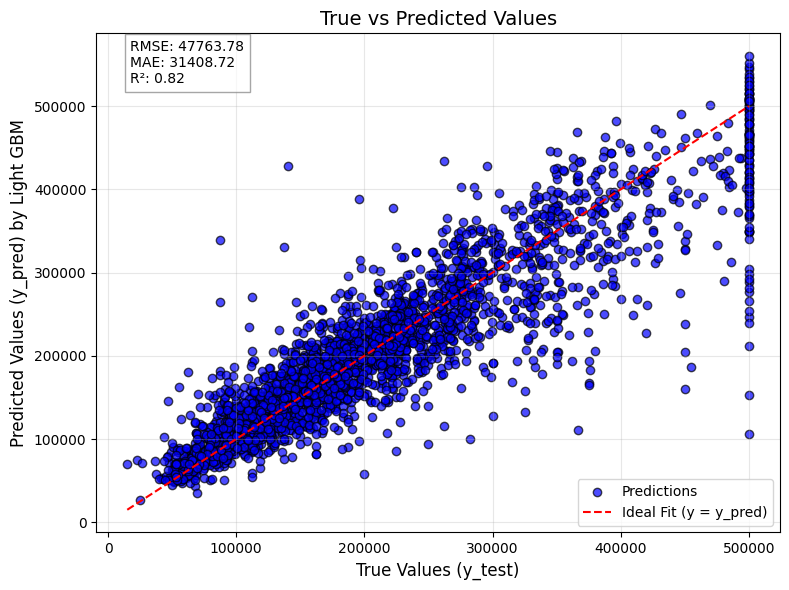

In [70]:
# Retrieve the best model from GridSearchCV
best_model = grid_search.best_estimator_

# Predict on the test set
y_test_pred = best_model.predict(X_test)

# Evaluate the model's performance on the test set
test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
test_mae = mean_absolute_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Scatter plot of true vs predicted values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, alpha=0.7, color='blue', edgecolors='k', label='Predictions')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], '--r', label='Ideal Fit (y = y_pred)')

# Add labels, title, and legend
plt.xlabel("True Values (y_test)", fontsize=12)
plt.ylabel("Predicted Values (y_pred) by Light GBM", fontsize=12)
plt.title("True vs Predicted Values", fontsize=14)
plt.legend(fontsize=10)

# Add RMSE and MAE to the plot
plt.text(
    0.05, 0.9,
    f"RMSE: {test_rmse:.2f}\nMAE: {test_mae:.2f}\nR²: {test_r2:.2f}",
    fontsize=10,
    transform=plt.gca().transAxes,
    bbox=dict(facecolor='white', alpha=0.7, edgecolor='gray')
)

# Show the plot
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

# H. Rules Based Prediciton

## 1. Rule Based Function

In [66]:
# Define the prediction function  
def predict_median_house_value(median_income, housing_median_age, ocean_proximity, total_rooms):    
    # Initialize base median house value based on median income    
    if median_income < 2.5:    
        median_house_value = 100000    
    elif median_income < 3.5:    
        median_house_value = 135000    
    elif median_income < 5.0 :    
        median_house_value = 220000    
    else:    
        median_house_value = 263750
    
    # Adjust based on housing median age    
    if housing_median_age < 18:    
        median_house_value *= 1.10  # Increase by 15%
    elif housing_median_age < 29: # Decrease by 5%
        median_house_value *= 0.95
    elif housing_median_age < 37:    
        median_house_value *= 0.90  # Decrease by 10%    
    
    # Adjust based on ocean proximity    
    if ocean_proximity == 'NEAR OCEAN':    
        median_house_value *= 1.05  # Increase by 15%    
    elif ocean_proximity == 'ISLAND':    
        median_house_value *= 1.30  # Increase by 30%
    elif ocean_proximity == 'NEAR BAY':    
        median_house_value *= 1.05  # Increase by 5%
    elif ocean_proximity == '<1H OCEAN':
        median_house_value *= 1.05  # Increase by 5%        
    
    # Adjust based on total rooms    
    if total_rooms > 3000:    
        median_house_value *= 1.05  # Increase by 5%    
    elif total_rooms < 1500:    
        median_house_value *= 0.85  # Decrease by 15%    
    
    return median_house_value    
  
# Apply the function to each row in the DataFrame  
df['rule_predicted'] = df.apply(lambda row: predict_median_house_value(  
    median_income=row['median_income'],  
    housing_median_age=row['housing_median_age'],  
    ocean_proximity=row['ocean_proximity'],  
    total_rooms=row['total_rooms']  
), axis=1)  
  
# Display the updated DataFrame  
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value,room_per_household,population_per_household,bedrooms_ratio,income_household,income_level,rule_predicted
0,-119.79,36.73,52.0,112.0,28.0,193.0,40.0,1.9750,INLAND,47500.0,2.800000,4.825000,0.250000,0.049375,1,85000.00
1,-122.21,37.77,43.0,1017.0,328.0,836.0,277.0,2.2604,NEAR BAY,100000.0,3.671480,3.018051,0.322517,0.008160,1,89250.00
2,-118.04,33.87,17.0,2358.0,396.0,1387.0,364.0,6.2990,<1H OCEAN,285800.0,6.478022,3.810440,0.167939,0.017305,2,304631.25
3,-118.28,34.06,17.0,2518.0,1196.0,3051.0,1000.0,1.7199,<1H OCEAN,175000.0,2.518000,3.051000,0.474980,0.001720,1,115500.00
4,-119.81,36.73,50.0,772.0,194.0,606.0,167.0,2.2206,INLAND,59200.0,4.622754,3.628743,0.251295,0.013297,1,85000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14442,-120.06,36.94,19.0,901.0,183.0,700.0,190.0,2.2375,INLAND,64300.0,4.742105,3.684211,0.203108,0.011776,1,80750.00
14443,-121.26,38.27,20.0,1314.0,229.0,712.0,219.0,4.4125,INLAND,144600.0,6.000000,3.251142,0.174277,0.020148,2,177650.00
14444,-120.89,37.48,27.0,1118.0,195.0,647.0,209.0,2.9135,INLAND,159400.0,5.349282,3.095694,0.174419,0.013940,1,109012.50
14446,-117.93,33.62,34.0,2125.0,498.0,1052.0,468.0,5.6315,<1H OCEAN,484600.0,4.540598,2.247863,0.234353,0.012033,2,249243.75


## 2. Rules Based Metric

In [67]:
   # Calculate the metrics    
mae = mean_absolute_error(df['median_house_value'], df['rule_predicted'])    
mse = mean_squared_error(df['median_house_value'], df['rule_predicted'])    
rmse = np.sqrt(mse)  # Calculate RMSE    
r2 = r2_score(df['median_house_value'], df['rule_predicted'])    
  
# Create a DataFrame to store the metrics    
rulebased_metric = pd.DataFrame({    
    'Metric': ['Mean Absolute Error', 'Mean Squared Error', 'Root Mean Squared Error', 'R-squared'],    
    'Value': [mae, mse, rmse, r2]    
})    

# Set display options to avoid scientific notation  
pd.set_option('display.float_format', '{:.6f}'.format)  
  
# Show Rule-based Prediction's metrics
rulebased_metric

,Metric,Value
0,Mean Absolute Error,70013.723032
1,Mean Squared Error,9483584558.957739
2,Root Mean Squared Error,97383.697604
3,R-squared,0.287872


Rule based price prediction showing larger deviation than the model.

### Scatter Plot of `median_house_value` and `rule_predicted`

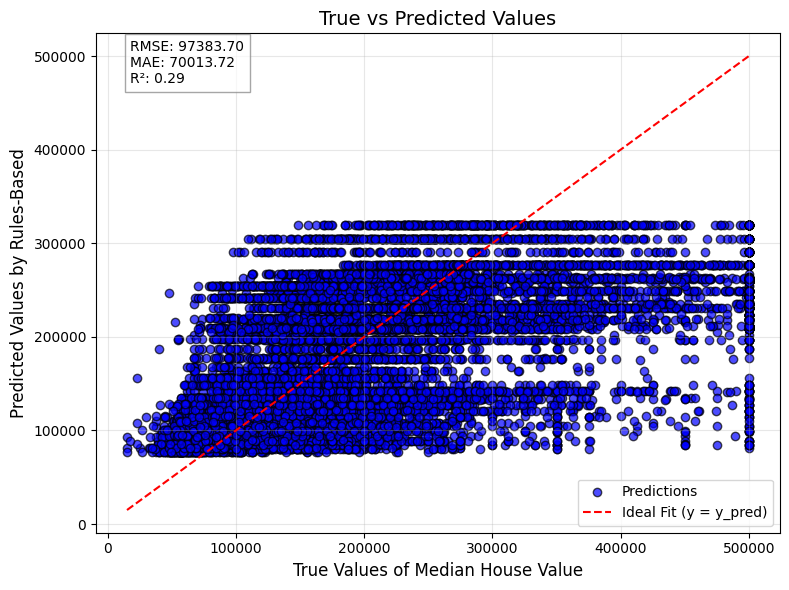

In [79]:
plt.figure(figsize=(8, 6))
plt.scatter(df['median_house_value'], df["rule_predicted"], alpha=0.7, color='blue', edgecolors='k', label='Predictions')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], '--r', label='Ideal Fit (y = y_pred)')

# Add labels, title, and legend
plt.xlabel("True Values of Median House Value", fontsize=12)
plt.ylabel("Predicted Values by Rules-Based", fontsize=12)
plt.title("True vs Predicted Values", fontsize=14)
plt.legend(fontsize=10)

# Add RMSE, MAE, and R² to the plot
plt.text(
    0.05, 0.9,
    f"RMSE: {rmse:.2f}\nMAE: {mae:.2f}\nR²: {r2:.2f}",
    fontsize=10,
    transform=plt.gca().transAxes,
    bbox=dict(facecolor='white', alpha=0.7, edgecolor='gray'))

# Show the plot
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

# I. CONCLUSION & RECOMMENDATION

## 1. Conclusion

The main goal of this project is to find a more accurate model compared to rule-based prediction. The aim is that house price predictions become more accurate and consistent.

By using features from the dataset, adding some new features, removing outliers, and trying several models while performing hyperparameter tuning, the LightGBM model provided the best metric values.

After comparing it with rule-based prediction, the results are also better.

The best model is LightGBM.

## 2. Conclusion on Housing Price


1.	**RMSE (Root Mean Square Error): 47,763.78**

This value represents the average deviation of the predicted house price from the true house price.

On average, the model's prediction could overestimate or underestimate the house price by approximately $47,764.

2.	**MAE (Mean Absolute Error): 31,408.72**

The MAE provides a simpler interpretation: the model's predictions are off by about $31,409, on average, regardless of whether the error is positive or negative.

3.	**Example of Impact:**

For a house priced at $300,000, the model might predict a value between $252,236 ($300,000 - $47,764) and $347,764 ($300,000 + $47,764) in the worst-case scenario (based on RMSE).

However, in most cases, the error is closer to $31,409, meaning the model might predict a range of approximately $268,591 to $331,409 for the same $300,000 house.

4.	**Practical Interpretation:**

$47,764 RMSE means that for high-value properties, this margin of error might be more acceptable (e.g., for a $1,000,000 house, 4.8% error).

However, for lower-value properties, this error becomes more significant. For example, on a $150,000 house, a $47,764 error represents 31.8% of the price, which could be problematic in some contexts.

**Conclusion:**

The average error ($31,409 MAE) suggests the model is reasonably accurate but still leaves room for improvement, especially for properties at the lower end of the pricing spectrum.


## 3. Model Limitation

**1.	Outdated Dataset (1990 Census):**

The dataset is based on housing data from 1990, which does not account for significant economic, demographic, or real estate trends over the last three decades (e.g., inflation, population growth, and housing market changes).

**2.	Feature Limitations:**

Missing Modern Influencing Factors: Important modern factors like zoning laws, recent housing developments, access to tech hubs, and proximity to new infrastructure are absent from the dataset.

**3.	Model Prediction Range:**

The model is constrained to the original price ranges in the dataset (capped at $500,000 in the 1990 data). Properties in today's market, which frequently exceed that cap, will likely result in underpredictions.

**4.	Error Magnitude (RMSE):**

While the RMSE of ~$47,764 is reasonable, it represents a significant margin of error for lower-priced homes. For buyers or sellers in the lower tier, this level of error could misguide decision-making.

## 4. Recommendation


**1.	Update the Dataset:**

Use a modern housing dataset that reflects current market conditions. Publicly available datasets, like Zillow’s housing data or recent census information, could provide better predictors for today’s housing prices.

**2.	Include Additional Features:**

Economic Indicators: Incorporate features like local GDP, average income, and employment rates.

Transportation and Amenities: Add features like proximity to highways, schools, hospitals, and public transportation.

**3.	Handle Categorical Features More Effectively:**

For "ocean proximity," consider creating a distance-based continuous variable instead of using a categorical representation. For instance, exact distances to the nearest coastline or major body of water could offer more precision.

**4.	Inflation Adjustment:**

Incorporate an inflation adjustment mechanism to transform 1990 prices into today’s dollars for more relevant predictions in a modern context.

**5.	Regular Updates:**

Re-train the model periodically using recent data to ensure predictions reflect the latest market trends and economic conditions.
